In [4]:
%matplotlib inline

In [2]:
import matplotlib.pyplot as plt
from skimage import io
from skimage import feature
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage as ndi
from skimage.morphology import binary_erosion,rectangle,binary_dilation,disk,closing,square,skeletonize
from ipywidgets import interact, interactive, fixed
import ipywidgets as widgets
from IPython.display import display

In [3]:

pathImg="C:/Users/Tobar/Desktop/TFG_DietaPorDientes/TrabajosPasadosPorJose/dietaJose/Automatico/"
nombreImg="ATP10 UE23 H1 2ori.jpg"

img = io.imread(pathImg+nombreImg)
from skimage.color import rgb2grey
img=rgb2grey(img)

In [5]:
from skimage.restoration import denoise_tv_chambolle, denoise_bilateral
from skimage import exposure

img_adapteq = exposure.equalize_adapthist(img, clip_limit=0.91,nbins =100)
img_adapteqDENO=denoise_tv_chambolle(img_adapteq, weight=0.1)

In [7]:
from skimage.feature import hessian_matrix, hessian_matrix_eigvals
from skimage.color import rgb2grey
#assume you have an image img
from skimage.restoration import denoise_tv_chambolle, denoise_bilateral
from skimage import exposure
import numpy as np
from scipy.ndimage import gaussian_filter
import matplotlib.pyplot as plt

from skimage import data
from skimage import img_as_float
from skimage.morphology import reconstruction
img_adapteq = exposure.equalize_adapthist(img, clip_limit=0.91,nbins =100)
img_adapteqDENO=denoise_tv_chambolle(img_adapteq, weight=0.1)

hxx, hxy, hyy = hessian_matrix(img_adapteqDENO, sigma=1.85,mode='wrap',cval=0.11)
i1, i2 = hessian_matrix_eigvals(hxx, hxy, hyy)

image = img_as_float(i1)
image = gaussian_filter(image, 1)

seed = np.copy(image)
seed[1:-1, 1:-1] = image.min()
mask = image
dilated = reconstruction(seed, mask, method='dilation')

im=image - dilated


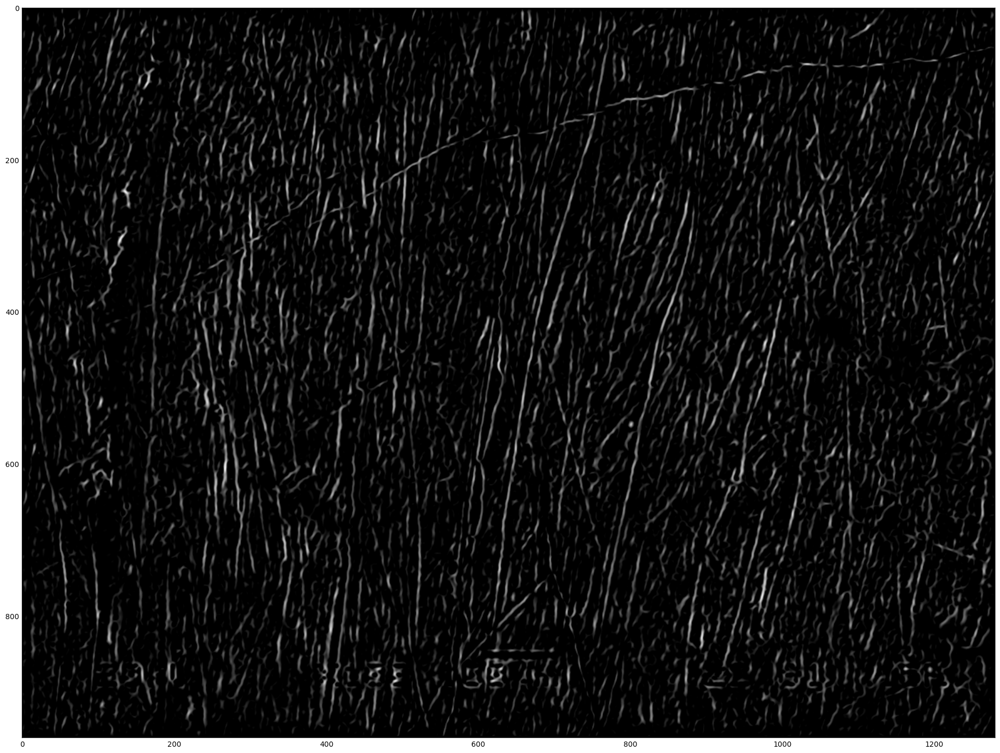

In [8]:
plt.figure(figsize=(24, 24))
plt.imshow(im,cmap='gray')

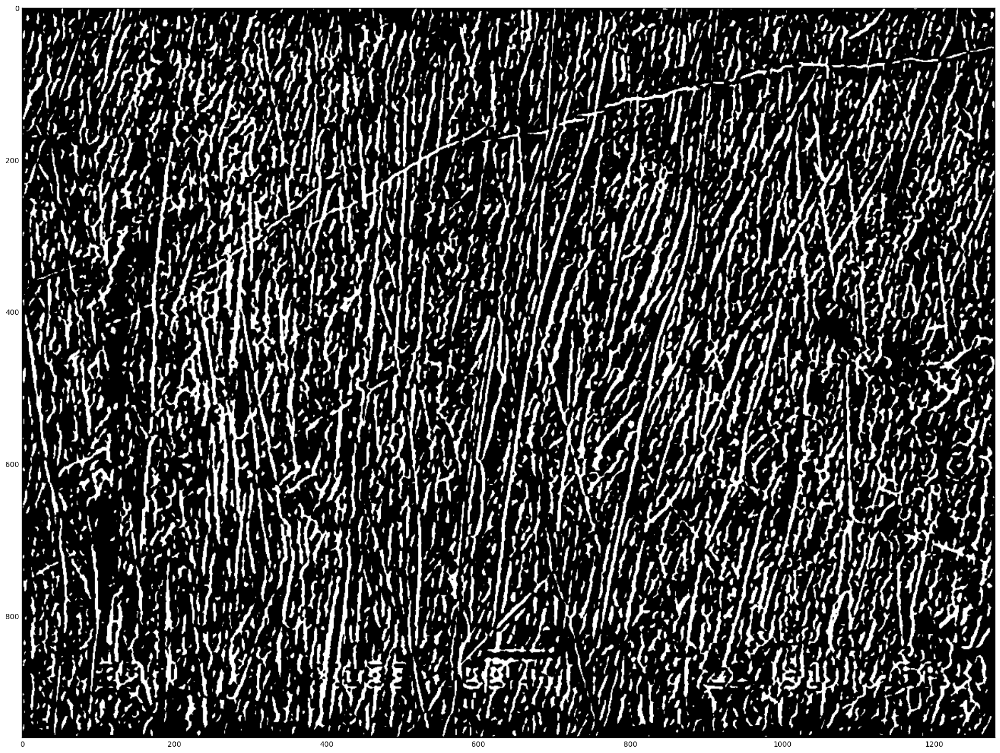

In [9]:

from skimage.filters import threshold_li
thresh = threshold_li(im)

thresholded = im >= thresh

plt.figure(figsize=(24, 24))
plt.imshow(thresholded,cmap='gray')

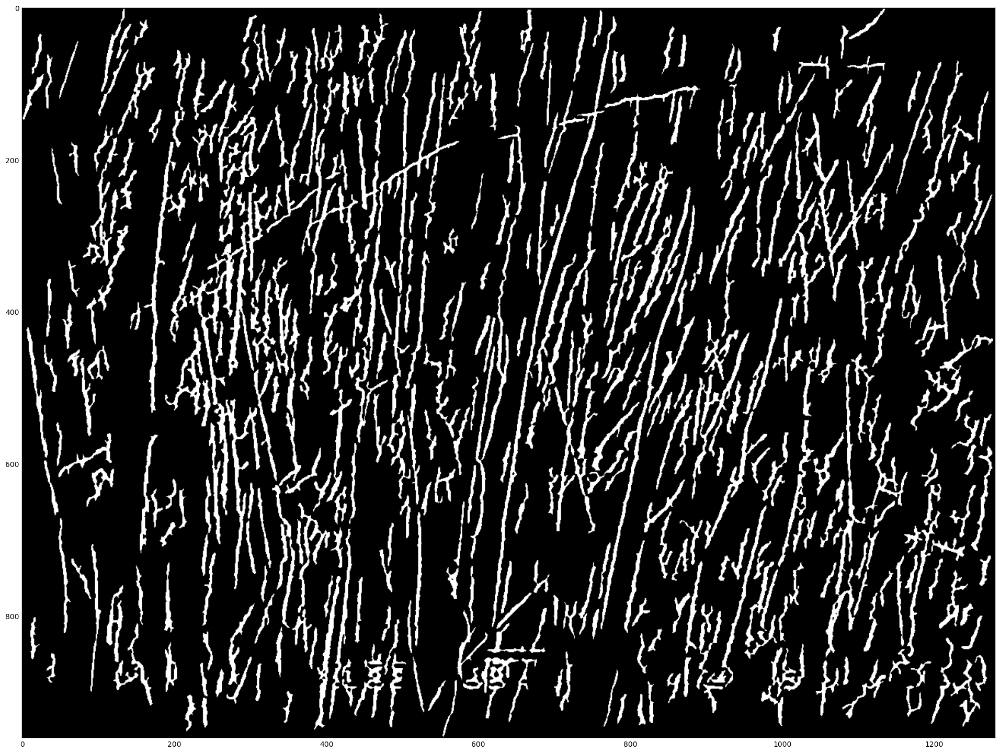

In [10]:
from skimage import morphology

no_small = morphology.remove_small_objects(thresholded, min_size=155,connectivity =100)

plt.figure(figsize=(24, 24))
plt.imshow(no_small,cmap='gray')

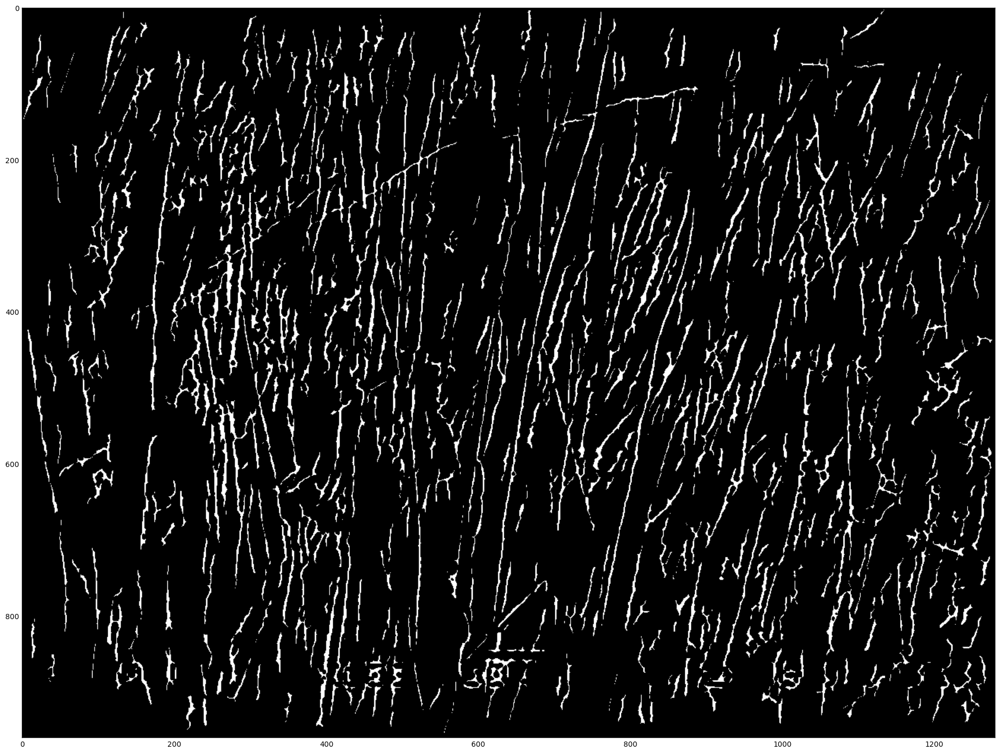

In [11]:
from skimage.morphology import binary_erosion,disk,diamond
#selem=disk(1)
selem=diamond(1.9)
dil=binary_erosion(no_small, selem, out=None)

plt.figure(figsize=(24, 24))
plt.imshow(dil,cmap='gray')

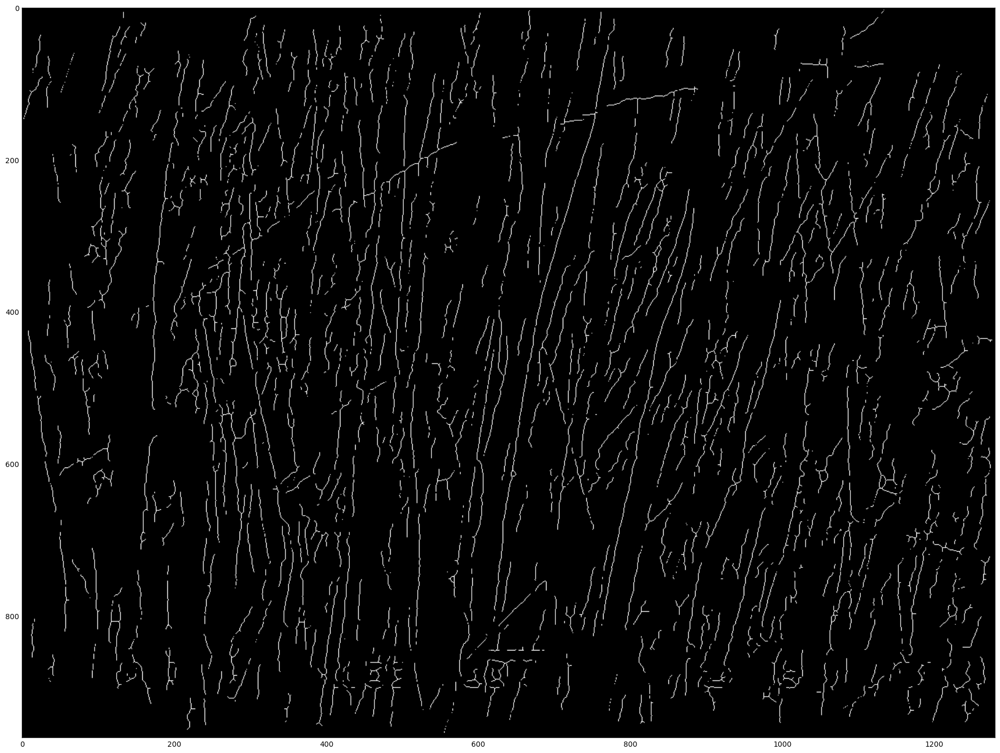

In [12]:
from skimage.morphology import skeletonize
skl=skeletonize(dil)
plt.figure(figsize=(24, 24))
plt.imshow(skl,cmap='gray')

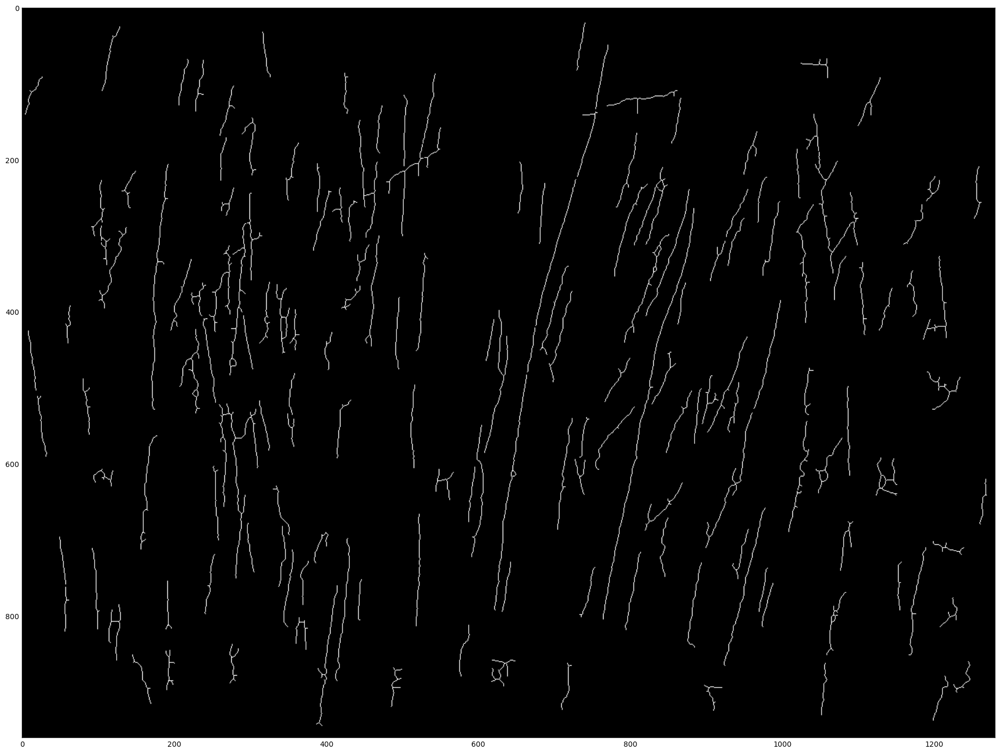

In [13]:
no_small2 = morphology.remove_small_objects(skl, min_size=55,connectivity =100)
plt.figure(figsize=(24, 24))
plt.imshow(no_small2,cmap='gray')

In [20]:
from skimage.transform import hough_line, hough_line_peaks,probabilistic_hough_line
def proHough(threshold,line_length,line_gap,sinRuido):
    lines = probabilistic_hough_line(sinRuido, threshold, line_length, line_gap)
    return lines 

In [21]:

def segmentsDistance(seg1, seg2):
    return segments_distance(seg1[0][0], seg1[0][1], seg1[1][0], seg1[1][1],
                             seg2[0][0], seg2[0][1], seg2[1][0], seg2[1][1])
#Entrada:
#        x11: Segmento 1 Punto 1 coordedana x
#        y11: Segmento 1 Punto 1 coordedana y
#        x12: Segmento 1 Punto 2 coordedana x
#        y12: Segmento 1 Punto 2 coordedana y 
#        x21: Segmento 2 Punto 1 coordedana x
#        y21: Segmento 2 Punto 1 coordedana y
#        x22: Segmento 2 Punto 2 coordedana x
#        y22: Segmento 2 Punto 2 coordedana y
#Funcion que calcula la distancia entre dos segmentos que no se cruzan 
#RETURN: min(distances) la distancia minima de todas las posibles distancias
def segments_distance(x11, y11, x12, y12, x21, y21, x22, y22):
    """distance between two segments in the plane:
    one segment is (x11, y11) to (x12, y12)
    the other is   (x21, y21) to (x22, y22)
    """
    if segments_intersect(x11, y11, x12, y12, x21, y21, x22, y22): 
            return 0
    # try each of the 4 vertices w/the other segment
    distances = []
    distances.append(point_segment_distance(x11, y11, x21, y21, x22, y22))
    distances.append(point_segment_distance(x12, y12, x21, y21, x22, y22))
    distances.append(point_segment_distance(x21, y21, x11, y11, x12, y12))
    distances.append(point_segment_distance(x22, y22, x11, y11, x12, y12))
    return min(distances)
#Entrada:
#        x11: Segmento 1 Punto 1 coordedana x
#        y11: Segmento 1 Punto 1 coordedana y
#        x12: Segmento 1 Punto 2 coordedana x
#        y12: Segmento 1 Punto 2 coordedana y 
#        x21: Segmento 2 Punto 1 coordedana x
#        y21: Segmento 2 Punto 1 coordedana y
#        x22: Segmento 2 Punto 2 coordedana x
#        y22: Segmento 2 Punto 2 coordedana y
#Funcion boleana que calcula si dos segmentos se cruzan o no
#RETURN: true/false si se cruzan o no 
def segments_intersect(x11, y11, x12, y12, x21, y21, x22, y22):
    """ whether two segments in the plane intersect:
      one segment is (x11, y11) to (x12, y12)
      the other is   (x21, y21) to (x22, y22)
    """
    dx1 = x12 - x11
    dy1 = y12 - y11
    dx2 = x22 - x21
    dy2 = y22 - y21
    delta = dx2 * dy1 - dy2 * dx1
    if delta == 0: 
        return False  # parallel segments
    s = (dx1 * (y21 - y11) + dy1 * (x11 - x21)) / delta
    t = (dx2 * (y11 - y21) + dy2 * (x21 - x11)) / (-delta)
    return (0 <= s <= 1) and (0 <= t <= 1)
#Entrada:
#        px: Punto coordenada x 
#        py: Punto coordenada y
#        x1: Punto 1 coordenada x 
#        y1: Punto 1 coordenada y
#        x2: Punto 2 coordenada x 
#        y2: Punto 2 coordenada y
#Funcion que calcula la distancia desde un punto dado a un segmento.
#RETURN: DIstancia desde el punto al segmento
def point_segment_distance(px, py, x1, y1, x2, y2):
    dx = x2 - x1
    dy = y2 - y1
    if dx == dy == 0:  # the segment's just a point
        return math.hypot(px - x1, py - y1)

    # Calculate the t that minimizes the distance.
    t = ((px - x1) * dx + (py - y1) * dy) / (dx * dx + dy * dy)

    # See if this represents one of the segment's
    # end points or a point in the middle.
    if t < 0:
        dx = px - x1
        dy = py - y1
    elif t > 1:
        dx = px - x2
        dy = py - y2
    else:
        near_x = x1 + t * dx
        near_y = y1 + t * dy
        dx = px - near_x
        dy = py - near_y

    return math.hypot(dx, dy)
#Entrada:
#        vA: Punto A
#        vB: Punto B
#Funcion que devuelve la multiplicacion de las coordenadas x de los dos puntos 
#mas la multiplicacion de las coordenadas y de los dos puntos
#Return: la multiplicacion de las coordenadas x de los dos puntos 
#        mas la multiplicacion de las coordenadas y de los dos puntos
def dot(vA, vB):
    return vA[0]*vB[0]+vA[1]*vB[1]
#Entrada:
#        lineA:linea o segmento A
#        lineB:linea o segmento A
#Funcion que dadas dos rectas calcula el angulo que forman entre ellas.
#Return ang_deg: Devuelve el angulo que forman dichas rectas en grados.
def ang(lineA, lineB):
    # Get nicer vector form
    vA = [(lineA[0][0]-lineA[1][0]), (lineA[0][1]-lineA[1][1])]
    vB = [(lineB[0][0]-lineB[1][0]), (lineB[0][1]-lineB[1][1])]
    # Get dot prod
    dot_prod = dot(vA, vB)
    # Get magnitudes
    magA = dot(vA, vA)**0.5
    magB = dot(vB, vB)**0.5
    # Get cosine value
    cos_ = dot_prod/magA/magB
    if cos_ > 1: cos_ =1
    # Get angle in radians and then convert to degrees
    angle = math.acos(cos_)
    # Basically doing angle <- angle mod 360
    ang_deg = math.degrees(angle)%360

    if ang_deg-180>=0:
        # As in if statement
        return 360 - ang_deg
    else: 
        return ang_deg
#Entrada:
#        epsilon1: Distancia que si superan dos rectas no une
#        epsilon2: Angulo que si superan dos rectas no une
#        lines: Lineas producidas al aplicar la transformada
#        G: Grafo donde añadir los nodos que tengamso que unir
#Funcion que combina las lineas cercanas producidas por la Transformada probabilistica
#de hough que cumplen ciertos parametros y las añade a un grafo. 
#RETURN: devolvemos el Grafo completo donde estan los nodos que hemso fusionado.
def combina(epsilon1,epsilon2,lines,G): 
    for i in range(len(lines)):
        G.add_node(i)

    for i in range(len(lines)-1):
        for j in range(i+1,len(lines)):
            distance = segmentsDistance(lines[i],lines[j])
            #print(angle)
            if distance <= epsilon1 :
                angle = ang(lines[i],lines[j])
                #print(distance)
                if angle <= epsilon2:
                    #print("combina ",i,j)
                    G.add_edge(i,j) 
    return G

#Entrada.
#        p1: Punto 1
#        p2: Punto 2
#Calculamos la distancia entre dos puntos.
#Return distancia entre los puntos.
def pointDistance(p1, p2):
    dx = p1[0] - p2[0]
    dy = p1[1] - p2[1]
    return (dx*dx + dy*dy)**0.5

#Entrada: segmentosList lista con todos los segmentos a combinar
#Combinamos los segmentos
#Lista con los segmentos combinados que calculamos con la teoria de grafos.
def combinaSegmentos(segmentosList):
    #print("combina",segmentosList)
    Xs=list(map(lambda x:[x[0][0],x[1][0]],segmentosList))
    Ys=list(map(lambda x:[x[0][1],x[1][1]],segmentosList))
    xMax=np.max(Xs)
    yMax=np.max(Ys)
    xMin=np.min(Xs)
    yMin=np.min(Ys)
    if (xMax,yMax) in set(map(lambda x:x[0],segmentosList)):
        #print("devuelvo",((xMax,yMax),(xMin,yMin)))
        return ((xMax,yMax),(xMin,yMin))
    else:
        #print("devuelvo",((xMax,yMin),(xMin,yMax)))
        return ((xMax,yMin),(xMin,yMax))
#Entrada.
#        k_components K_componentes del grafo en el que decimos que rectas tenemos que unir
#        lines lineas calculadas por la tranformada de hough
#Funcion que dadas las lineas calculadas y las que nos marca el grafo que tenemso que unir
#devuelve lso segmentos que de verdad ha detectado el algoritmo
def segmentosVerdad(k_components,lines):
    segmentosDeVerdad = []
    for i in range(len(k_components[1])):
        segmentos=list(map(lambda x:lines[x],k_components[1][i]))
        segmentosDeVerdad.append(combinaSegmentos(segmentos))
    return segmentosDeVerdad

In [24]:
def longitud_linea( p,valor=100):
    """
    Funcion que calcula la longitud de un segmento.

    @param p: segmento del que calcular su distancia.

    @Return distancia del segmento
    """

    valor=int(valor)
    long_ref=int(valor)
    long_seg=(((p[1][0] - p[0][0]) ** 2) + ((p[1][1] - p[0][1]) ** 2)) ** (1 / 2)

    return (long_seg*valor)/long_ref

In [33]:
import networkx as nx
import math
from networkx.algorithms import approximation as apxa

def obtencion_lineas(no_small2):
    lines=proHough(30,20,30,no_small2) 
    G = nx.Graph()
    G = combina(8,4, lines, G)
    k_components = apxa.k_components(G)
    segmentos_de_verdad = segmentosVerdad(k_components, lines)

    segmentos_de_verdad_pintar=[]
    for i in segmentos_de_verdad:
        if longitud_linea(i,100) > 10:
            segmentos_de_verdad_pintar.append(i)
    return segmentos_de_verdad_pintar,lines

In [38]:
segmentos_de_verdad_pintar,jjr=obtencion_lineas(no_small2)

In [39]:
def mostrar(imagen,segmentos):
    plt.figure(figsize=(75, 75)) 
    plt.imshow(imagen, cmap=plt.cm.gray)
    for line in segmentos:
        p0, p1 = line
        plt.plot((p0[0], p1[0]), (p0[1], p1[1]),linewidth=9)
    #fig.savefig('foo.jpg',bbox_inches='tight')
    print(len(segmentos),"hay 15 lineas realmente")

181 hay 15 lineas realmente


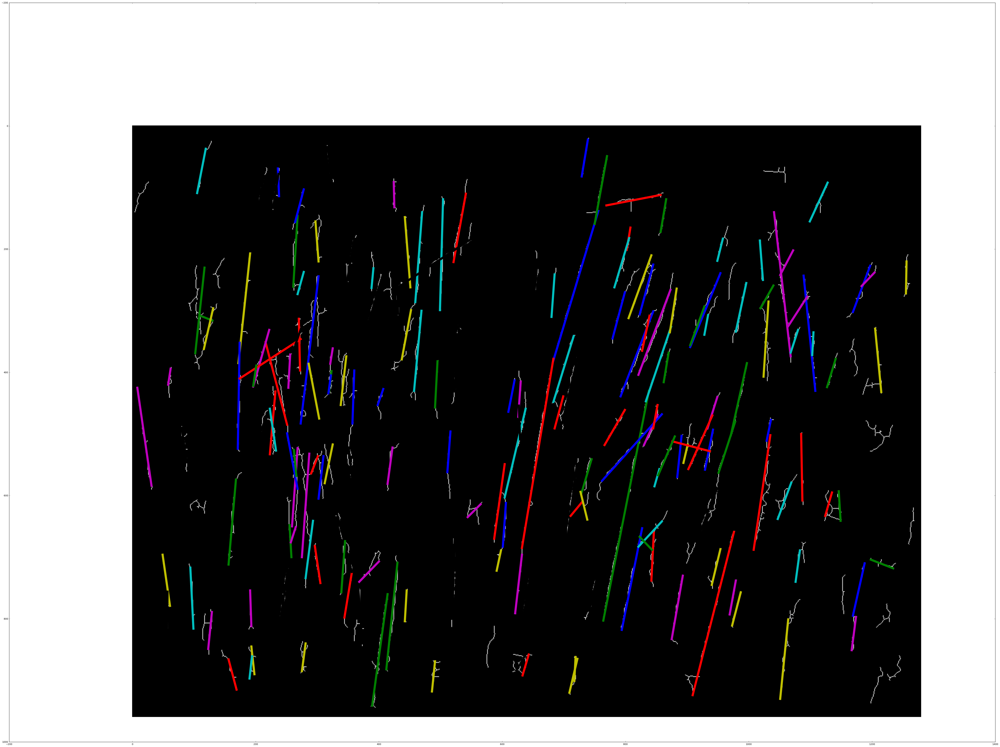

In [40]:
mostrar(no_small2,jj)

183 hay 15 lineas realmente


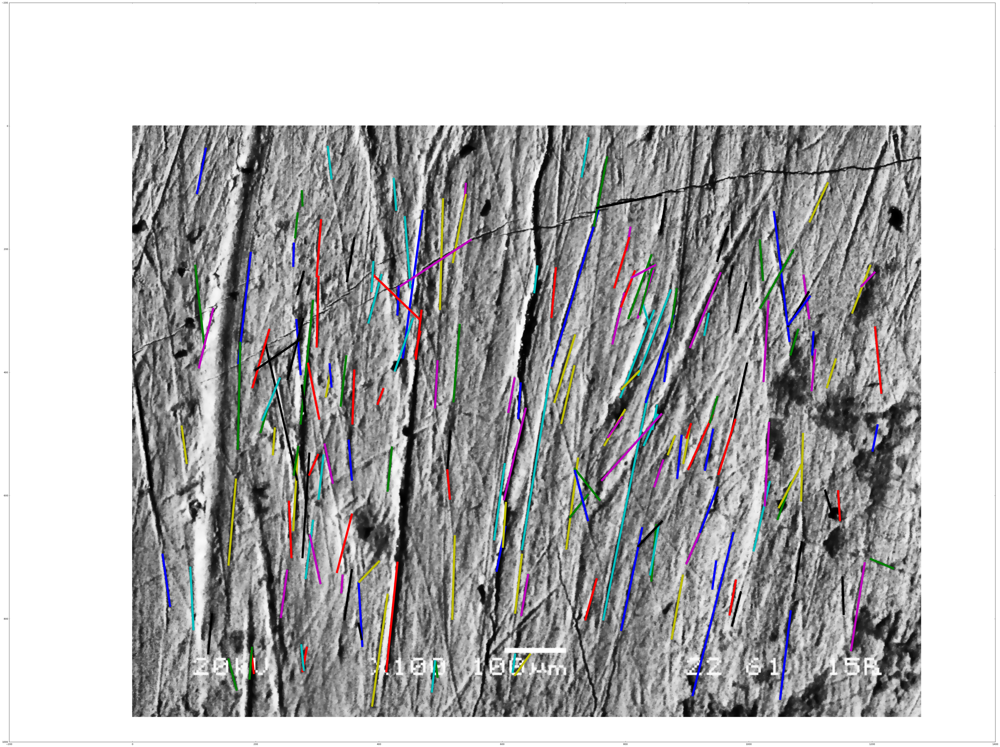

In [41]:
mostrar(img_adapteqDENO,segmentos_de_verdad_pintar)